# Group 21 hence 21mod 6 = 3 +1 = 4 
SPY5.L   + SPY5z.CHIX + SPY5.P  


Workflow:
- data loading
- percentage log returns
- EDA (time evolution, distribution, PACF, ACF)
- Ljung box test based on the combinations of p,q found in ACF and PACF --) ARMA model implied
- Rolling window or expanding window for best p,q combinations of ARMA evaluated on AIC,SBIC,HQIC information criterion on test set


In [1]:
import pandas as pd
import numpy as np
from scipy.stats import kurtosis, skew

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

from statsmodels.tsa.api import VAR
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.stats.diagnostic import acorr_ljungbox

from sklearn.metrics import mean_squared_error


Unnamed: 0    0
DateTime      0
symbol        0
price         0
dtype: int64
symbol
SPY5.P        216274
SPY5.L        213633
SPY5z.CHIX    194176
Name: count, dtype: int64
          Unnamed: 0                       DateTime          price  \
count  213632.000000                         213632  213632.000000   
mean   315375.922142  2024-10-30 15:20:27.815776512     515.376515   
min         2.000000            2024-01-02 09:02:00     415.374731   
25%    163961.750000            2024-06-03 13:11:45     483.795402   
50%    305666.500000            2024-10-29 11:56:30     514.113524   
75%    467779.250000            2025-03-31 10:49:15     542.481572   
max    631889.000000            2025-08-29 17:29:00     589.851331   
std    188177.680449                            NaN      39.540871   

         log_returns  
count  213632.000000  
mean        0.000111  
min        -7.448239  
25%        -0.007546  
50%         0.000224  
75%         0.007907  
max         6.431138  
std         

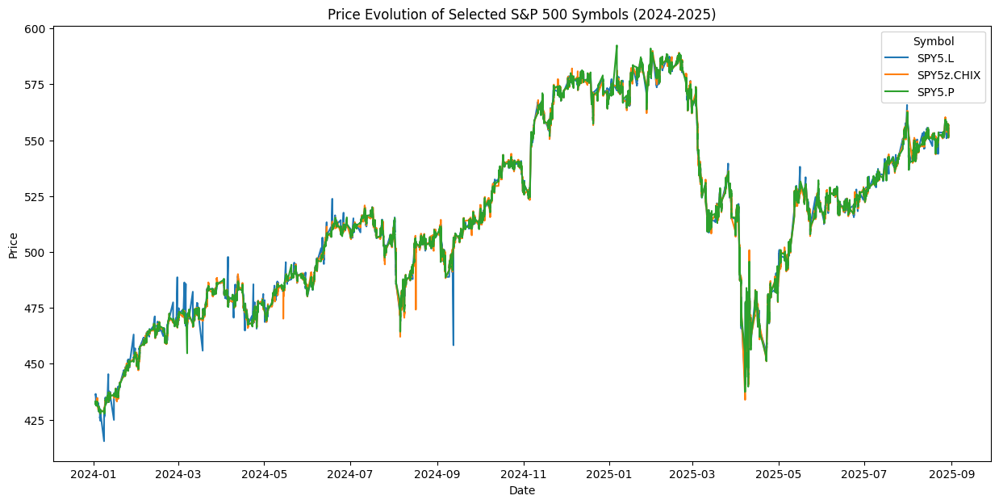

In [2]:
df_snp = pd.read_csv('output/sp_g21.csv')
df_snp['DateTime'] = pd.to_datetime(df_snp['DateTime']) # Ensure DateTime is in datetime format
print(df_snp.isnull().sum()) # no missing values

print(df_snp["symbol"].value_counts())


dfSPY_p = df_snp[df_snp['symbol'] == 'SPY5.L'].copy()
dfSPY_p['log_returns'] = 100 *  np.log(dfSPY_p['price'] / dfSPY_p['price'].shift(1)) # Log returns in percentage
dfSPY_p = dfSPY_p.dropna() # Drop NA values resulting from the shift operation
print(dfSPY_p.describe())
print(dfSPY_p.head())

# Plot the evolution of prices for each symbol

plt.figure(figsize=(15, 7))
sns.lineplot(data=df_snp, x='DateTime', y='price', hue='symbol')
plt.title('Price Evolution of Selected S&P 500 Symbols (2024-2025)')

plt.xlabel('Date')
plt.ylabel('Price')
plt.legend(title='Symbol')

plt.show()

In [3]:


# This single line creates a fully interactive plot
fig = px.line(df_snp, x='DateTime', y='price', color='symbol', 
              title='Interactive Price Evolution of S&P 500 Symbols')

# In a notebook, this will display the plot with zoom/pan controls
fig.show()

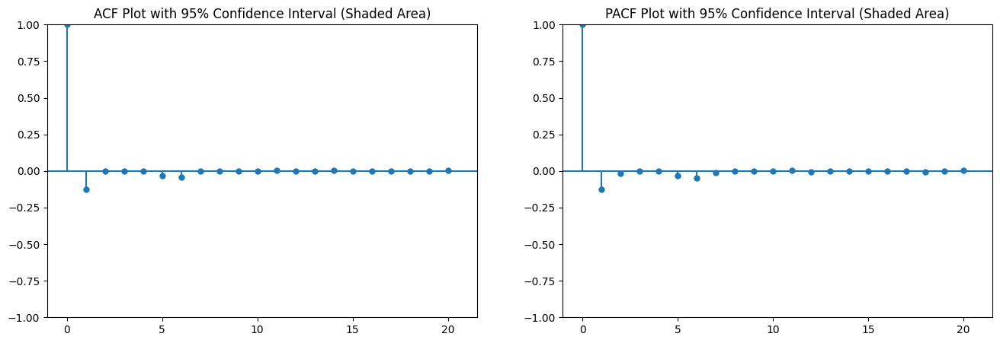

In [4]:
fig, axes = plt.subplots(1, 2, figsize=(16, 5))
plot_acf(dfSPY_p['log_returns'], ax=axes[0], lags=20, alpha=0.05)
plot_pacf(dfSPY_p['log_returns'], ax=axes[1], lags=20, method='ywm', alpha=0.05)

axes[0].set_title("ACF Plot with 95% Confidence Interval (Shaded Area)")
axes[1].set_title("PACF Plot with 95% Confidence Interval (Shaded Area)")
plt.show()

--- Diagnostics for Resampled Data ---
count    42758.000000
mean         0.000553
std          0.133196
min         -7.448239
25%         -0.020511
50%          0.000923
75%          0.022591
max          9.624918
Name: price, dtype: float64
------------------------------------


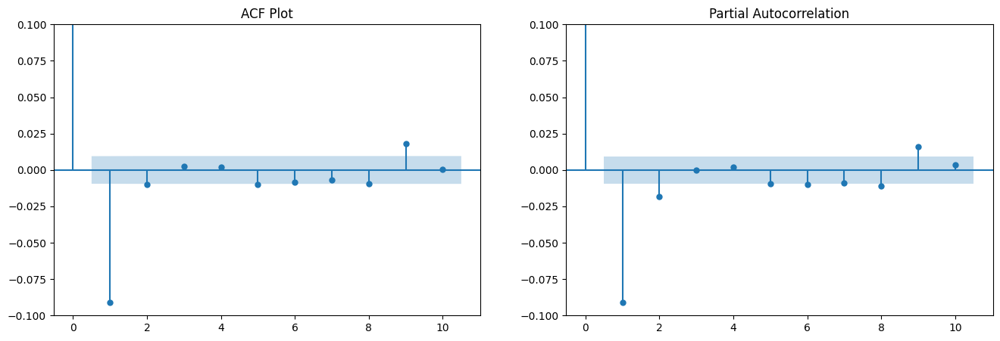

In [5]:
dfSPY_p['DateTime'] = pd.to_datetime(dfSPY_p['DateTime'])
dfSPY_p.set_index('DateTime', inplace=True)

price_resampled = dfSPY_p['price'].resample('5min').last().dropna()

# Resample to 5-minute frequency
log_returns_resampled = 100 * np.log(price_resampled / price_resampled.shift(1))
clean_log_returns = log_returns_resampled.dropna()

# Plot the ACF and PACF of the resampled series
print("--- Diagnostics for Resampled Data ---")
print(clean_log_returns.describe())
print("------------------------------------")

fig, axes = plt.subplots(1, 2, figsize=(16, 5))
plot_acf(clean_log_returns, ax=axes[0], lags=10, alpha=0.05)
plot_pacf(clean_log_returns, ax=axes[1], lags=10, alpha=0.05)
axes[0].set_ylim(-0.1, 0.1)
axes[1].set_ylim(-0.1, 0.1)
axes[0].set_title("ACF Plot")
plt.show()

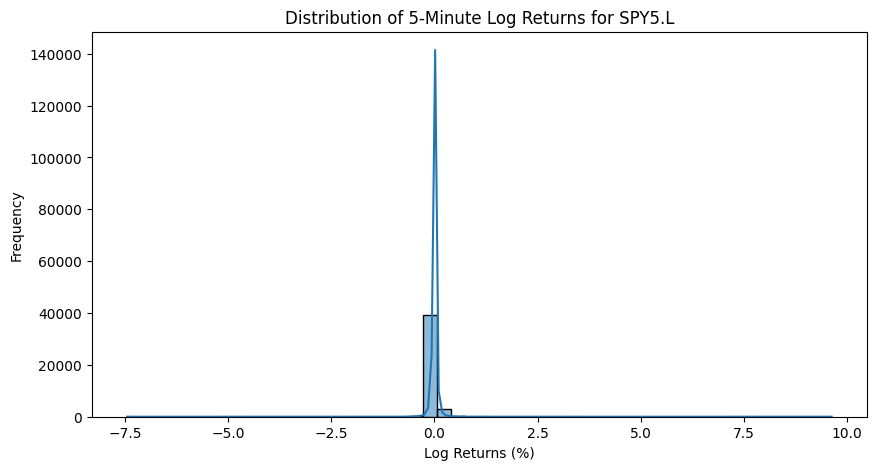

In [6]:
# Plot distribution of log returns
plt.figure(figsize=(10, 5))
sns.histplot(clean_log_returns, bins=50, kde=True)
plt.title('Distribution of 5-Minute Log Returns for SPY5.L')
plt.xlabel('Log Returns (%)')
plt.ylabel('Frequency')
plt.show()

In [7]:
# Calculate the percentage of outliers in this sample beyond 3 standard deviations
std_dev = clean_log_returns.std()
outliers = clean_log_returns[(clean_log_returns > 3 * std_dev) | (clean_log_returns < -3 * std_dev)]
outlier_percentage = (len(outliers) / len(clean_log_returns)) * 100 
print(f"Percentage of outliers beyond 3 standard deviations: {outlier_percentage:.4f}%")

Percentage of outliers beyond 3 standard deviations: 0.7461%


In [8]:
from statsmodels.stats.diagnostic import acorr_ljungbox

# Run the Ljung-Box test on the log returns
# We can test for autocorrelation up to, for example, 10 lags
ljung_box_results = acorr_ljungbox(clean_log_returns, lags=[10], return_df=True)

print(ljung_box_results)

       lb_stat     lb_pvalue
10  387.217373  4.935403e-77


In [ ]:
# --- Loop to find the optimal ARMA(p,q) order ---
max_order = 10 # Maximum order for p and q to test
results = []

for p in range(max_order + 1):
    for q in range(max_order + 1):
        try:
            # Fit an ARMA(p,q) model (which is an ARIMA(p,0,q))
            model = ARIMA(clean_log_returns, order=(p, 0, q)).fit()
            
            # Store the results
            results.append({
                'p': p,
                'q': q,
                'AIC': model.aic,
                'BIC': model.bic,
                'HQIC': model.hqic
            })
        except Exception as e:
            # Handle cases where the model fails to converge
            print(f"Failed to fit ARMA({p},{q}). Error: {e}")
            continue

# Create a DataFrame from the results for easy viewing
results_df = pd.DataFrame(results)

print("--- Information Criteria for ARMA(p,q) Models ---")
print(results_df)

# Find the optimal (p,q) for each criterion
optimal_aic = results_df.loc[results_df['AIC'].idxmin()]
optimal_bic = results_df.loc[results_df['BIC'].idxmin()]
optimal_hqic = results_df.loc[results_df['HQIC'].idxmin()]

print("\n--- Optimal Model Orders ---")
print(f"Optimal according to AIC: ARMA({int(optimal_aic['p'])}, {int(optimal_aic['q'])})")
print(f"Optimal according to BIC: ARMA({int(optimal_bic['p'])}, {int(optimal_bic['q'])})")
print(f"Optimal according to HQIC: ARMA({int(optimal_hqic['p'])}, {int(optimal_hqic['q'])})")

c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provide

--- Information Criteria for ARMA(p,q) Models ---
      p   q           AIC           BIC          HQIC
0     0   0 -51049.642405 -51032.315782 -51044.175169
1     0   1 -51415.606683 -51389.616749 -51407.405829
2     0   2 -51417.534391 -51382.881145 -51406.599919
3     0   3 -51415.815386 -51372.498828 -51402.147296
4     0   4 -51413.829836 -51361.849967 -51397.428128
..   ..  ..           ...           ...           ...
116  10   6 -51438.727163 -51282.787555 -51389.522039
117  10   7 -51457.243907 -51292.640987 -51405.305164
118  10   8 -51463.053737 -51289.787505 -51408.381376
119  10   9 -51458.735366 -51276.805823 -51401.329387
120  10  10 -51455.740284 -51265.147428 -51395.600686

[121 rows x 5 columns]

--- Optimal Model Orders ---
Optimal according to AIC: ARMA(10, 8)
Optimal according to BIC: ARMA(0, 1)
Optimal according to HQIC: ARMA(2, 8)


In [ ]:


# --- Choose your final model based on the criteria above (e.g., BIC) ---
best_p = int(optimal_bic['p'])
best_q = int(optimal_bic['q'])

print(f"\n--- Fitting final ARMA({best_p},{best_q}) model for diagnostics ---")
final_model = ARIMA(clean_log_returns, order=(best_p, 0, best_q)).fit()

# Get the model residuals
residuals = final_model.resid

# --- Perform the Ljung-Box test on the residuals ---
# Check for autocorrelation up to a reasonable number of lags (e.g., 20)
ljung_box_results = acorr_ljungbox(residuals, lags=[20], return_df=True)

print("\n--- Ljung-Box Test on Model Residuals ---")
print(ljung_box_results)

# Interpretation
p_value = ljung_box_results['lb_pvalue'].values[0]
if p_value > 0.05:
    print(f"\nP-value ({p_value:.4f}) is greater than 0.05.")
    print("Conclusion: The residuals appear to be independent (Good Fit).")
else:
    print(f"\nP-value ({p_value:.4f}) is less than 0.05.")
    print("Conclusion: There is significant autocorrelation in the residuals (Bad Fit).")


--- Fitting final ARMA(0,1) model for diagnostics ---


c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)



--- Ljung-Box Test on Model Residuals ---
       lb_stat     lb_pvalue
20  103.316109  3.197252e-13

P-value (0.0000) is less than 0.05.
Conclusion: There is significant autocorrelation in the residuals (Bad Fit).


In [ ]:


# --- The model suggested by AIC ---
best_p = 4
best_q = 3

print(f"\n--- Fitting the ARMA({best_p},{best_q}) model suggested by AIC ---")
final_model_aic = ARIMA(clean_log_returns, order=(best_p, 0, best_q)).fit()

# Get the residuals from this new model
residuals_aic = final_model_aic.resid

# --- Perform the Ljung-Box test on the new residuals ---
ljung_box_results_aic = acorr_ljungbox(residuals_aic, lags=[20], return_df=True)

print("\n--- Ljung-Box Test on ARMA(4,3) Model Residuals ---")
print(ljung_box_results_aic)

# Interpretation
p_value = ljung_box_results_aic['lb_pvalue'].values[0]
if p_value > 0.05:
    print(f"\nP-value ({p_value:.4f}) is greater than 0.05.")
    print("Conclusion: The residuals appear to be independent (Good Fit).")
else:
    print(f"\nP-value ({p_value:.4f}) is less than 0.05.")
    print("Conclusion: There is significant autocorrelation in the residuals (Bad Fit).")


--- Fitting the ARMA(4,3) model suggested by AIC ---


c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Coco\AppData\Local\Programs\Python\Python312\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting au


--- Ljung-Box Test on ARMA(4,3) Model Residuals ---
      lb_stat     lb_pvalue
20  78.245613  7.777829e-09

P-value (0.0000) is less than 0.05.
Conclusion: There is significant autocorrelation in the residuals (Bad Fit).


# V2 Worflow

C:\Users\Coco\AppData\Local\Temp\ipykernel_16196\3577601021.py:2: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  hourly_log_returns = clean_log_returns.resample('1H').sum().dropna()



Percentage of hourly outliers beyond 3 std devs: 1.5349%

Daily Log Returns Kurtosis: 250.2361
Daily Log Returns Skewness: -0.4019


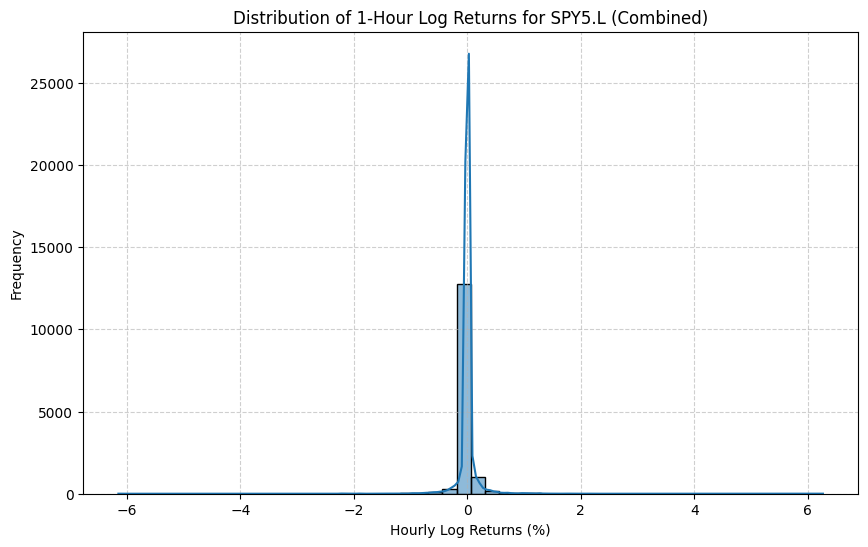

In [ ]:

# Resample 5minute log returns to 1-hour by summing them
hourly_log_returns = clean_log_returns.resample('1H').sum().dropna()

# Calculate the percentage of outliers for the hourly data ---
hourly_std_dev = hourly_log_returns.std()
hourly_outliers = hourly_log_returns[(hourly_log_returns > 3 * hourly_std_dev) | (hourly_log_returns < -3 * hourly_std_dev)]
hourly_outlier_percentage = (len(hourly_outliers) / len(hourly_log_returns)) * 100 
print(f"\nPercentage of hourly outliers beyond 3 std devs: {hourly_outlier_percentage:.4f}%")

# Kurtosis and Skewness
hourly_kurtosis = kurtosis(hourly_log_returns)
hourly_skewness = skew(hourly_log_returns)
print(f"\nDaily Log Returns Kurtosis: {hourly_kurtosis:.4f}")
print(f"Daily Log Returns Skewness: {hourly_skewness:.4f}")


# --- 3. Plot the combined distribution of all hourly returns ---
plt.figure(figsize=(10, 6))
sns.histplot(hourly_log_returns, bins=50, kde=True)
plt.title('Distribution of 1-Hour Log Returns for SPY5.L (Combined)')
plt.xlabel('Hourly Log Returns (%)')
plt.ylabel('Frequency')
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()


Percentage of daily outliers beyond 3 std devs: 2.3102%

Daily Log Returns Kurtosis: 11.1995
Daily Log Returns Skewness: -0.8376


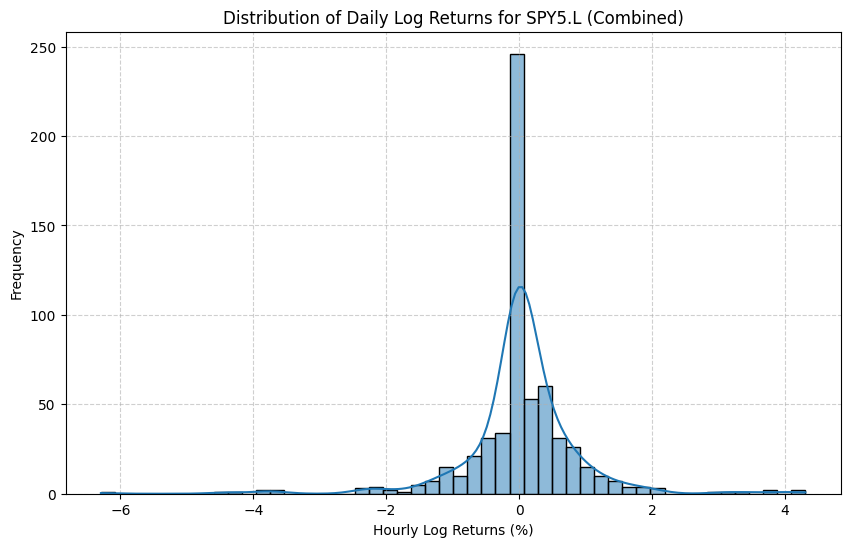

In [ ]:

# Resample 5minute log returns to 1-hour by summing them
daily_log_returns = clean_log_returns.resample('1D').sum().dropna()

# Calculate the percentage of outliers for the daily data ---
daily_std = daily_log_returns.std()
daily_outliers = daily_log_returns[(daily_log_returns > 3 * daily_std) | (daily_log_returns < -3 * daily_std)]
daily_outlier_percentage = (len(daily_outliers) / len(daily_log_returns)) * 100
print(f"\nPercentage of daily outliers beyond 3 std devs: {daily_outlier_percentage:.4f}%")

# Kurtosis and Skewness
daily_kurtosis = kurtosis(daily_log_returns)
daily_skewness = skew(daily_log_returns)
print(f"\nDaily Log Returns Kurtosis: {daily_kurtosis:.4f}")
print(f"Daily Log Returns Skewness: {daily_skewness:.4f}")

# --- 3. Plot the combined distribution of all hourly returns ---
plt.figure(figsize=(10, 6))
sns.histplot(daily_log_returns, bins=50, kde=True)
plt.title('Distribution of Daily Log Returns for SPY5.L (Combined)')
plt.xlabel('Hourly Log Returns (%)')
plt.ylabel('Frequency')
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

Identified 457 outliers across the entire sample period.


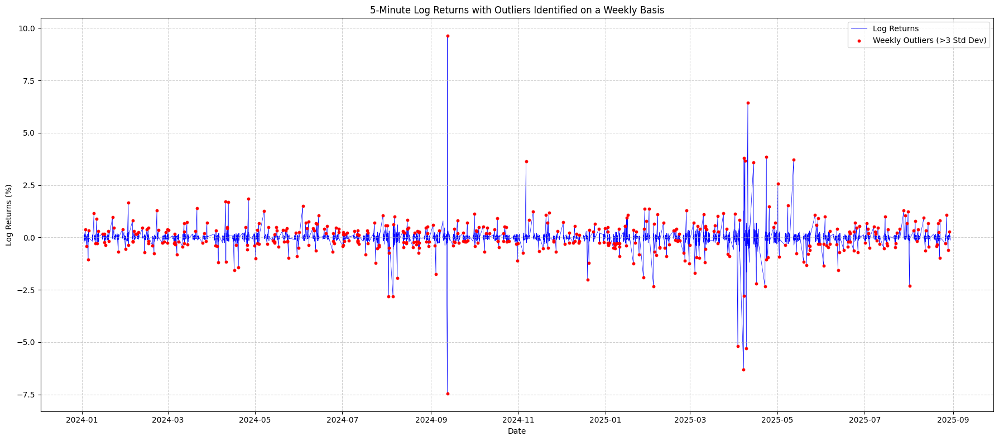

In [10]:
# This assumes 'clean_log_returns' is your 5-minute log return Series.

# --- 1. Calculate Weekly Mean and Std Dev for Every Data Point ---
# The transform() method is powerful: it performs a groupby calculation
# but returns a Series with the original index.
weekly_mean = clean_log_returns.groupby(pd.Grouper(freq='W')).transform('mean')
weekly_std = clean_log_returns.groupby(pd.Grouper(freq='W')).transform('std')

# --- 2. Define Outlier Bounds Based on Weekly Stats ---
upper_bound = weekly_mean + 3 * weekly_std
lower_bound = weekly_mean - 3 * weekly_std

# --- 3. Identify all points that are outliers relative to their own week ---
outliers = clean_log_returns[(clean_log_returns > upper_bound) | (clean_log_returns < lower_bound)]

print(f"Identified {len(outliers)} outliers across the entire sample period.")

# --- 4. Plot the Entire Time Series with All Outliers Highlighted ---
plt.figure(figsize=(18, 8))

# Plot the main time series
plt.plot(clean_log_returns.index, clean_log_returns, label='Log Returns', color='b', zorder=1, linewidth=0.5)

# Plot the identified outliers as red scatter points on top
plt.scatter(outliers.index, outliers, color='r', label='Weekly Outliers (>3 Std Dev)', zorder=2, s=10)

plt.title('5-Minute Log Returns with Outliers Identified on a Weekly Basis')
plt.xlabel('Date')
plt.ylabel('Log Returns (%)')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

In [ ]:
# Let's use the ARMA(2,2) model which was a strong candidate.
p, q = 2, 2
model_name = f'ARMA({p},{q})'

# --- 1. Split Data into Training and a 1-Hour Test Set ---
test_horizon = 12 # 12 periods * 5 minutes = 60 minutes
train_data = clean_log_returns[:-test_horizon]
test_data = clean_log_returns[-test_horizon:]

# --- 2. Fit the ARMA Model on the Full Training Set ---
print(f"Fitting {model_name} on all available training data...")
model = ARIMA(train_data, order=(p, 0, q))
fitted_model = model.fit()

# --- 3. Forecast the Next 12 Steps (1 Hour) ---
forecast = fitted_model.forecast(steps=test_horizon)

# --- 4. Plot the Forecast vs. Actual Values ---
plt.figure(figsize=(12, 6))
plt.plot(test_data.index, test_data, label='Actual Returns', marker='o')
plt.plot(test_data.index, forecast, label='Forecasted Returns', linestyle='--', marker='x')
plt.title(f'{model_name} Forecast vs. Actuals for the Next Hour')
plt.xlabel('Time')
plt.ylabel('Log Returns (%)')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:

#import warnings
#warnings.filterwarnings("ignore") # Suppress convergence and other warnings for a cleaner output

# --- 1. Define the (p,q) combinations based on your ACF/PACF analysis ---
# Let's test the most likely candidates based on your observations.
combinations_to_test = [
    (1, 1), (1, 2), (2, 1), (2, 2), # Low-order combinations
    (1, 9), (9, 1), # High-order combinations based on significant spikes
    (2, 8), (8, 2)
]

# --- 2. Loop through combinations, fit models, and get statistics ---
results_list = []

for p, q in combinations_to_test:
    model_name = f'ARMA({p},{q})'
    print(f"Fitting {model_name}...")
    
    try:
        # Fit the ARMA model on the training data
        model = ARIMA(train_data, order=(p, 0, q))
        result = model.fit()
        
        # Get the residuals for the Ljung-Box test
        residuals = result.resid
        
        # Perform the Ljung-Box test on the residuals
        lb_test = acorr_ljungbox(residuals, lags=[20], return_df=True)
        lb_pvalue = lb_test['lb_pvalue'].values[0]
        
        # Append all results to our list
        results_list.append({
            'Model': model_name,
            'p': p,
            'q': q,
            'AIC': result.aic,
            'BIC': result.bic,
            'HQIC': result.hqic,
            'Ljung-Box p-value': lb_pvalue
        })
        
    except Exception as e:
        print(f"Could not fit {model_name}. Error: {e}")
        continue

# --- 3. Create a final summary DataFrame and display the results ---
summary_df = pd.DataFrame(results_list)
summary_df = summary_df.sort_values(by='BIC') # Sort by BIC, a common choice

print("\n--- In-Sample Model Comparison ---")
print(summary_df)

In [ ]:
# This assumes 'clean_log_returns' is your 5-minute log return Series.

# --- 1. Split Data into Train, Holdout, and Test Sets ---
test_size = 12  # Last 1 hour for the final test set
holdout_size = 102 * 5 # Approx. 1 week of trading (102 5-min periods per day * 5 days)

test_data = clean_log_returns[-test_size:]
holdout_data = clean_log_returns[-(holdout_size + test_size):-test_size]
train_data = clean_log_returns[:-(holdout_size + test_size)]

print(f"Data Split:")
print(f"Training set size:   {len(train_data)}")
print(f"Holdout set size:    {len(holdout_data)}")
print(f"Test set size:       {len(test_data)}")
print("-" * 40)


# --- 2. In-Sample Identification on Training Data ---
# Define the (p,q) combinations to test
combinations_to_test = [
    (1, 1), (1, 2), (2, 1), (2, 2), (0, 1), (1, 0) # Add a few simple ones
]

results_list = []
for p, q in combinations_to_test:
    model_name = f'ARMA({p},{q})'
    try:
        model = ARIMA(train_data, order=(p, 0, q)).fit()
        lb_test = acorr_ljungbox(model.resid, lags=[20], return_df=True)
        results_list.append({
            'Model': model_name, 'p': p, 'q': q, 'AIC': model.aic, 'BIC': model.bic,
            'Ljung-Box p-value': lb_test['lb_pvalue'].values[0]
        })
    except Exception as e:
        continue
summary_df = pd.DataFrame(results_list).sort_values(by='BIC')
print("\n--- In-Sample Model Comparison (on Training Data) ---")
print(summary_df)
print("-" * 40)


# --- 3. Expanding Window Validation on Holdout Set ---
# We will test the models identified above
holdout_mse_results = {}

for p, q in combinations_to_test:
    model_name = f'ARMA({p},{q})'
    print(f"Running expanding window for {model_name} on holdout set...")
    
    history = list(train_data)
    predictions = []
    
    for t in range(len(holdout_data)):
        model = ARIMA(history, order=(p, 0, q))
        model_fit = model.fit()
        yhat = model_fit.forecast()[0]
        predictions.append(yhat)
        history.append(holdout_data.iloc[t]) # This is the "expanding" part
        
    mse = mean_squared_error(holdout_data, predictions)
    holdout_mse_results[model_name] = mse

# --- 4. Compare Out-of-Sample Performance on Holdout Set ---
print("\n--- Expanding Window Holdout Set Results (Lower MSE is Better) ---")
for model, mse in sorted(holdout_mse_results.items(), key=lambda item: item[1]):
    print(f"Model: {model}, Holdout MSE: {mse:.8f}")